In [1]:
import pandas as pd

# importing nltk for NLP (Natural language Programming)
import nltk
#nltk.download('averaged_perceptron_tagger')
#nltk.download('wordnet')
#nltk.download('maxent_ne_chunker')
#nltk.download('words')

# text processing
# lowering the text
# tokenizing the text by slippting text into words and removing punctuationsa
# remove words that contain numbers
# removal of english stopwords
# POS(Part-of-speech) assigns every word a tag to determine if it is a noun, verb
# adverb or adjective. 
# lemmatize the text is to transform the text into their root form 
# (e.g. rooms -> room, slept -> sleep) 
# Wordnet is a lexicon database where a word could be defines wiith its meaning.
# Using Named Entity Recognition we grouped words together as a noun phrase
from nltk.corpus import wordnet
import string
from nltk import pos_tag, ne_chunk
from nltk.corpus import stopwords
from nltk.tokenize import WhitespaceTokenizer
from nltk.stem import WordNetLemmatizer

# Sentiment Analysis
#nltk.download('vader_lexicon')
# Vader is az lexicon i.e. dictionary of words that evaluates sentiments to a particular word
# sentiments like neg, neu, pos
# By providing vader with review text we undertsnad the polarity of the review.
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# Using TextBlob we can assign a sentiment score and segment the reviews as positive or negative
from textblob import TextBlob

# Plots
import matplotlib.pyplot as plt
import seaborn as sns

#word clouds
import heapq
from wordcloud import WordCloud, STOPWORDS
from PIL import Image
import collections
import matplotlib.cm as cm
from matplotlib import rcParams
from tqdm import tqdm

# Create numerical vector of every word 
from gensim.test.utils import common_texts

# Using Doc2vec enables the machine to predict the next phrase.
# for e.g. catch the ball is a phrase in Doc2vec it first looks at the document if the doc type is 
# technology then the maschine knows instead of catch the ball a plausible solution would be catch the bug/exception.
# If it was sports then catch the ball would be perfect.
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

# Extracting importance of words in the corpus
from sklearn.feature_extraction.text import TfidfVectorizer


In [6]:
# Reading the data
yelp_df = pd.read_excel(r'Yelp.xlsx')

In [7]:
# Drop all the uneccessary columns frolm the dataframe
yelp_df = yelp_df.drop(['business_id', 'name_x', 'date', 'user_id', 'review_id', 'stars_y', 'useful_y', 'funny_y','cool_y', 'postal_code'], axis = 1)
# Check the rows and columns of the dataframe
yelp_df.shape

(13549, 1)

In [8]:
#sample the data for speedy computation
#This allows better results of words useful for analysing sentiments
yelp_df = yelp_df.sample(frac = 0.5, replace = False, random_state = 42)
yelp_df.shape

(6774, 1)

In [11]:
# TEXT PRE_PROCESSING - Clean the review text data 
# Returning if the word is adj or noun or verb or adverb
def get_wordnet(pos_tag):
    if pos_tag.startswith('J'):
        return wordnet.ADJ
    elif pos_tag.startswith('V'):
        return wordnet.VERB
    elif pos_tag.startswith('N'):
        return wordnet.NOUN
    elif pos_tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN    

def clean_text(text):
    # lower case
    text = str(text).lower()
    # tokenize text and remove punctuations
    text = [word.strip(string.punctuation) for word in text.split(" ")]
    # remove words that contain numbers
    text = [word for word in text if not any(c.isdigit() for c in word)]
     # remove stop words
    stop = stopwords.words('english')
    text = [x for x in text if x not in stop]
    # remove empty tokens
    text = [t for t in text if len(t) > 0]
    # pos tag text
    pos_tags = pos_tag(text)
    print (pos_tags)
    # lemmatize text
    # t[0] is the first word in the pos_tags
    # get_wordnet(t[1]) is the first pos_tag i.e. is it adj, nn, v, rb
    text = [WordNetLemmatizer().lemmatize(t[0], get_wordnet(t[1])) for t in pos_tags]
    # remove words with only one letter
    text = [t for t in text if len(t) > 1]
    # join all
    text = " ".join(text)
    return(text)
    

In [24]:
# yelp_df.head()

,text,text_clean
811,I've been here at least a half dozen times but...,i've least half dozen time always lunch want r...
13472,The staff was very attentive and personable. ...,staff attentive personable ate twice night sta...
12501,I always go to this grand lux at the palazzo b...,always go grand lux palazzo work usually lunch...
8456,Family and I came here for a birthday party la...,family come birthday party last night really g...
6415,Best indian food I've ever had in my life! No...,best indian food i've ever life greasy fresh f...


In [10]:
# clean text data
yelp_df["text_clean"] = yelp_df["text"].apply(lambda x: clean_text(x))
#yelp_df.shape

[("i've", 'NN'), ('least', 'JJS'), ('half', 'JJ'), ('dozen', 'NN'), ('times', 'NNS'), ('always', 'RB'), ('lunch', 'VBP'), ('want', 'JJ'), ('real', 'JJ'), ('authentic', 'JJ'), ('version', 'NN'), ('come', 'NN'), ('dinner', 'NN'), ('serving', 'VBG'), ("i've", 'JJ'), ('waiting', 'VBG'), ('review', 'NN'), ('dinner', 'NN'), ('service', 'NN'), ('dissapointed!\n', 'NN'), ('\nmy', 'NNP'), ('friend', 'NN'), ('arrived', 'VBD'), ('print', 'JJ'), ('nights', 'NNS'), ('menu', 'VBP'), ('yes', 'RB'), ('print', 'JJ'), ('piece', 'JJ'), ('paper', 'NN'), ('like', 'IN'), ('turn', 'JJ'), ('report', 'NN'), ('history', 'NN'), ('teacher', 'RB'), ('told', 'VBD'), ('served', 'VBN'), ('tonight', 'NN'), ('chef', 'NN'), ('marc', 'NN'), ('boss', 'IN'), ('dynamic', 'JJ'), ('menu.\n\nfor', 'JJ'), ('evening', 'NN'), ('shared', 'VBN'), ('escargot', 'VBD'), ('appetizer', 'JJ'), ('pasta', 'NN'), ('fagioli', 'NN'), ('escargot', 'VBD'), ('heavenly', 'RB'), ('garlic', 'JJ'), ('salty', 'NN'), ('heavy', 'JJ'), ('pasta', 'NN'), 

In [32]:
# Convert column text into string
yelp_df["text"] = yelp_df["text"].astype(str)

# add sentiment anaylsis columns
# Using vader lexicon of nltk package we assign sentiment to words with the help of SentimentIntensityAnalyzer  
sid = SentimentIntensityAnalyzer()

# Assigning its sentiments to sentiments column 
yelp_df["sentiments"] = yelp_df["text"].apply(lambda x: sid.polarity_scores(x))
yelp_df = pd.concat([yelp_df.drop(['sentiments'], axis=1), yelp_df['sentiments'].apply(pd.Series)], axis=1)

yelp_df.shape

(6774, 6)

In [33]:
# In order to segregate the pos and neg reviews assigning positive and negative polarity.
yelp_df['sentiment_score'] = yelp_df['text'].map(lambda text: TextBlob(text).sentiment.polarity)

#classify sentiment into positive and negative ones
yelp_df['sentiment'] = ''
yelp_df['sentiment'][yelp_df['sentiment_score'] > 0] = 'positive'
yelp_df['sentiment'][yelp_df['sentiment_score'] <= 0] = 'negative'

yelp_df.shape

D:\IDE\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
D:\IDE\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


(6774, 8)

In [34]:
# Sample data
yelp_df.head(10)

,text,text_clean,neg,neu,pos,compound,sentiment_score,sentiment
811,I've been here at least a half dozen times but...,i've least half dozen time always lunch want r...,0.010,0.770,0.220,0.9961,0.125320,positive
13472,The staff was very attentive and personable. ...,staff attentive personable ate twice night sta...,0.000,0.815,0.185,0.8977,0.350833,positive
12501,I always go to this grand lux at the palazzo b...,always go grand lux palazzo work usually lunch...,0.030,0.847,0.123,0.9793,0.144127,positive
8456,Family and I came here for a birthday party la...,family come birthday party last night really g...,0.077,0.627,0.296,0.9610,0.273413,positive
6415,Best indian food I've ever had in my life! No...,best indian food i've ever life greasy fresh f...,0.128,0.599,0.272,0.8727,0.423438,positive
3434,My recommendation: Ube Cake\n\nI absolutely LO...,recommendation ube cake\n\ni absolutely love u...,0.058,0.869,0.073,0.5766,0.023129,positive
3120,I feel betrayed and cannot trust yelp anymore....,feel betray cannot trust yelp anymore nothing ...,0.207,0.793,0.000,-0.9371,-0.241667,negative
7745,I live across the street from here and occasio...,live across street occasionally pop head aroun...,0.080,0.834,0.087,0.2331,-0.060688,negative
4010,"This is based solely on their fried chicken, w...",base solely fried chicken happen crave thank t...,0.000,0.766,0.234,0.9456,0.341250,positive
2910,Great pizza! Service was great. The portion wa...,great pizza service great portion massive ingr...,0.000,0.662,0.338,0.9228,0.480000,positive


Text(0, 0.5, 'Count of reviews')

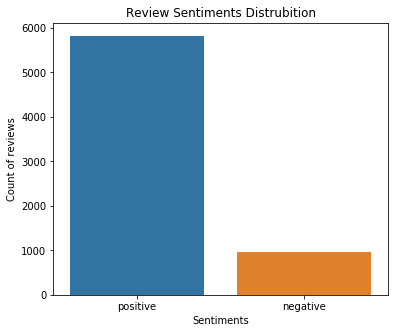

In [35]:
# Comparison between positive and negative reviews 
plt.figure(figsize=(6,5))
ax = sns.countplot(yelp_df['sentiment'])
plt.title('Review Sentiments Distrubition')
plt.xlabel('Sentiments')
plt.ylabel('Count of reviews')

In [36]:
# add number of characters column
yelp_df["nb_chars"] = yelp_df["text"].apply(lambda x: len(x))

# add number of words column
yelp_df["nb_words"] = yelp_df["text"].apply(lambda x: len(x.split(" ")))

In [95]:
# For sentiment analysis to be done the document i.e. text_clean column needs to be converted into vector

# create doc2vec vector columns
docs = [TaggedDocument(doc, [i]) for i, doc in enumerate(yelp_df["text_clean"].apply(lambda x: x.split(" ")))]

# build a Doc2Vec model and train with our text data
model = Doc2Vec(docs, vector_size=5, window=2, min_count=1, workers=4)

# transform each document into a vector data
doc2vec_df = yelp_df["text_clean"].apply(lambda x: model.infer_vector(x.split(" "))).apply(pd.Series)
doc2vec_df.columns = ["doc2vec_vector_" + str(x) for x in doc2vec_df.columns]
yelp_df = pd.concat([yelp_df, doc2vec_df], axis=1)
#yelp_df
doc2vec_df

,doc2vec_vector_0,doc2vec_vector_1,doc2vec_vector_2,doc2vec_vector_3,doc2vec_vector_4
811,-0.164326,0.654405,-0.785945,-0.530413,0.725515
13472,-0.098716,0.245638,-0.063331,0.003493,0.244954
12501,0.273471,0.154225,-0.826457,-0.048587,-0.090228
8456,-0.053278,0.033565,-0.284188,-0.093195,-0.056132
6415,-0.025808,-0.179792,-0.122560,-0.019566,0.208983
...,...,...,...,...,...
3001,-0.071154,0.029311,-0.203753,-0.192277,0.240555
12018,-0.340048,0.202522,-0.538439,-0.834331,0.099561
8658,-0.015804,0.037361,-0.244962,-0.144310,0.134214
8375,0.062518,0.138327,-0.081245,-0.016034,0.197993


In [38]:
# TFID inverses the documents to eveluate how important a word is to the document in the corpus

# add tf-idfs columns for every word
tf_idf = TfidfVectorizer(min_df = 10)
tf_idf_result = tf_idf.fit_transform(yelp_df["text_clean"]).toarray()
tf_idf_df = pd.DataFrame(tf_idf_result, columns = tf_idf.get_feature_names())
tf_idf_df.columns = ["word_" + str(x) for x in tf_idf_df.columns]
tf_idf_df.index = yelp_df.index
yelp_df = pd.concat([yelp_df, tf_idf_df], axis=1)
tfidf_df

,word_able,word_about,word_absolute,word_absolutely,word_ac,word_accent,word_accept,word_acceptable,word_access,word_accessible,...,word_you,word_young,word_your,word_yuck,word_yum,word_yummy,word_zaba,word_zabas,word_zero,word_zucchini
811,0.0,0.0,0.0,0.079317,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13472,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12501,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8456,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6415,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3001,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12018,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8658,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8375,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [39]:
Yelp_pos = pd.DataFrame(yelp_df['text_clean'][yelp_df['sentiment'] == 'positive'])
Yelp_neg = pd.DataFrame(yelp_df['text_clean'][yelp_df['sentiment'] == 'negative'])

In [ ]:
#yelp_df.to_csv(r'D:\Project\Preliminary\Yelp_Sentiment_word_transform1.csv', index = False)
#yelp_df.shape

In [40]:
add_stopwords = ['mainly','review','vega', 'quali', 'hig', 'stop', 'ihop', 'din','pal', 'pop','kari','bite','old','saw','ate','jeff','star','try','provide','breakfas','chicago', 'loca', 'anthony', 'disappointed', 'angelinas', 'yelp', 'new', 'cold', 'hot', 'ol', 'sa', 'seem', 'eback', 'ne', 'felt', 'day', 'almost', 'normally', 'cam', 'spend', 'dog', 'fan', 'use', 'hour', 'sigh', 'big', 'windy', 'skinny', 'previously', 'seriously', 'give', 'st', 'restaur', 'buffalo', 'want', 'ngra', 'year', 'call','disappointing', 'vegas', 'city', 'house', 'yum', 'pt', 'beef', 'something', 'must', 'look', 'write', 'take', 'waste', 'different','soggy','disappoint','half','come','accu','non','aroun','ny','ok','las','anyon', 'ding','sadl','keep','yelped','lux', 'grand','columns','The','foo','I','ve','sp','kep','positive','negative', 'text_clean', 'nb_words', 'sentiment score', 'word_year', 'word_yummy', 'word_yum', 'word_yet', 'word_young', 'word_zucchni', 'word_york', 'word_you', 'word_yelp', 'word_yes', 'nb_chars', 'rows', 'sta', 'la', 'neg', 'pos', 'Th']


# Add meaningless words into stopwords
for i in range(len(add_stopwords)):
    STOPWORDS.add(add_stopwords[i])

In [41]:
# wordcloud function

def show_wordcloud(data, title):
    wc = WordCloud(
        background_color = 'white',
        max_words = 200,
        max_font_size = 40, 
        scale = 3,
        random_state = 42,
        stopwords = set(STOPWORDS)
    ).generate(str(data))

    fig = plt.figure(1, figsize = (20, 20))
    plt.axis('off')
    if title: 
        plt.title(title, fontsize=40,color='Black')

    plt.imshow(wc)
    plt.show()
    


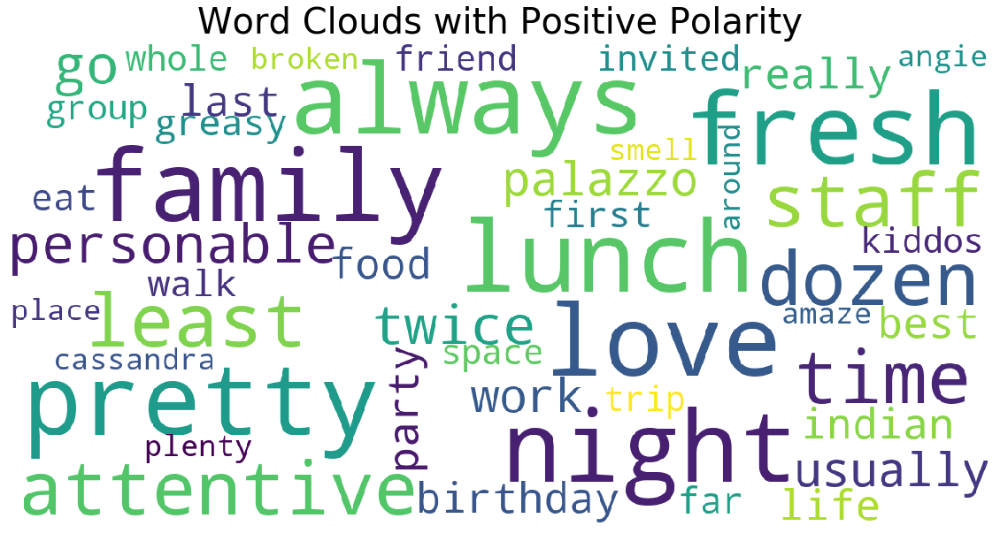

In [42]:
# print wordcloud
show_wordcloud(Yelp_pos, "Word Clouds with Positive Polarity")

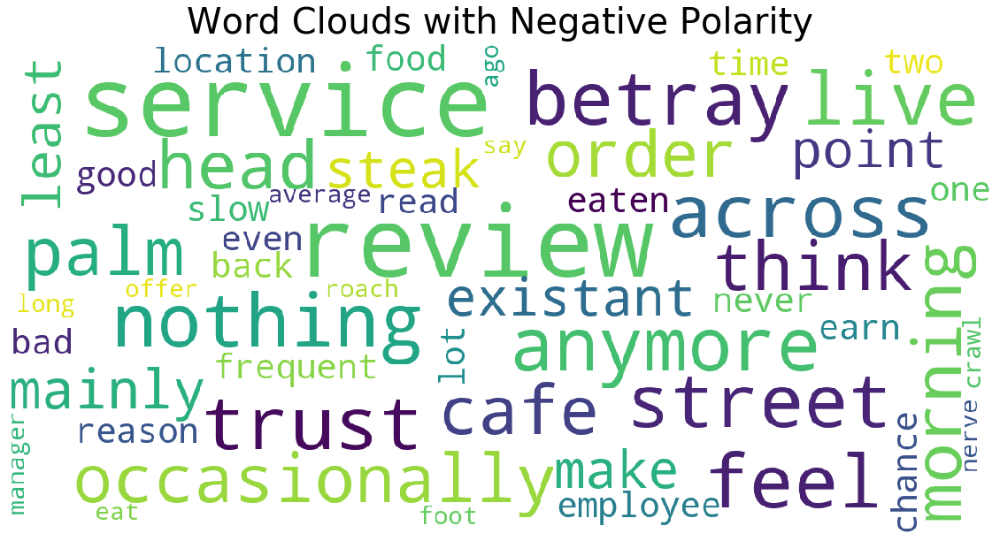

In [43]:
# print wordcloud
show_wordcloud(Yelp_neg, "Word Clouds with Negative Polarity")

In [44]:
# Perform sentiment analysis on Grand Lux Cafe 
GC_df = pd.read_csv('Grand_Lux_Cafe.csv')
GC_df = GC_df.drop(['text_length','Unnamed: 0','business_id', 'name_x', 'date', 'user_id', 'review_id', 'stars_y', 'useful_y', 'funny_y','cool_y'], axis = 1)
GC_df

,text
0,5 stars for the staff.\n\nPacked throughout th...
1,This review is purely for the late night dinin...
2,Another Dessert Adventure in the middle of the...
3,Went to the Grand Lux Cafe while at the Palazz...
4,Ok so we got here for lunch the other day got ...
...,...
1220,Awesome service and food. Come here every year...
1221,Really excellent food from the creators of the...
1222,Great food. Service was a little slow. Try the...
1223,"This restaurant was amazing, you have to try s..."


In [45]:
# clean text data
GC_df["text_clean"] = GC_df["text"].apply(lambda x: clean_text(x))
GC_df.shape

[('stars', 'NNS'), ('staff.\n\npacked', 'VBD'), ('throughout', 'IN'), ('day', 'NN'), ('warmer', 'JJ'), ('months', 'NNS'), ('basically', 'RB'), ('cheesecake', 'VBP'), ('factory', 'NN'), ('shortened', 'VBN'), ('dining', 'VBG'), ('menu', 'NN'), ('extended', 'VBD'), ('drink', 'NN'), ('menu', 'NN'), ('wonder', 'NN'), ('breakfast', 'NN'), ('brunch', 'NN'), ('service', 'NN'), ('highlight', 'VBD'), ('morning', 'NN'), ('options.\n\nyou', 'NN'), ('get', 'VBP'), ('showbiz', 'JJ'), ('locals', 'NNS'), ('still', 'RB'), ('think', 'VBP'), ('cheesecake', 'VB'), ('factory', 'NN'), ('something', 'NN'), ('miraculous', 'JJ'), ('short-term', 'JJ'), ('general', 'JJ'), ('hospital', 'NN'), ('actress', 'NN'), ('gone', 'VBN'), ('internet', 'JJ'), ('soap', 'NN'), ('acting', 'VBG'), ('go', 'VB'), ('little', 'JJ'), ('diva', 'JJ'), ('us', 'PRP'), ('clearly', 'RB'), ('wanted', 'VBD'), ('attention', 'NN'), ('however', 'RB'), ('prominently', 'RB'), ('sat', 'JJ'), ('end', 'NN'), ('aisle', 'NN'), ('booth...in', 'NN'), ('

(1225, 2)

In [47]:
# Add sentiments to review text for grand luc cafe
GC_df["GC_sentiments"] = GC_df["text"].apply(lambda x: sid.polarity_scores(x))
GC_df = pd.concat([GC_df.drop(['GC_sentiments'], axis=1), GC_df['GC_sentiments'].apply(pd.Series)], axis=1)

GC_df.shape

(1225, 6)

In [48]:
# Assign positive and negative polarity

GC_df['GC_sentiment_score'] = GC_df['text'].map(lambda text: TextBlob(text).sentiment.polarity)

#classify sentiment into positive and negative ones
GC_df['GC_sentiment'] = ''
GC_df['GC_sentiment'][GC_df['GC_sentiment_score'] > 0] = 'positive'
GC_df['GC_sentiment'][GC_df['GC_sentiment_score'] <= 0] = 'negative'

GC_df.shape
GC_df.head(10)

D:\IDE\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
D:\IDE\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,text,text_clean,neg,neu,pos,compound,GC_sentiment_score,GC_sentiment
0,5 stars for the staff.\n\nPacked throughout th...,star staff.\n\npacked throughout day warm mont...,0.000,0.904,0.096,0.8990,0.151786,positive
1,This review is purely for the late night dinin...,review purely late night din order take one ni...,0.062,0.887,0.051,-0.2658,0.002814,positive
2,Another Dessert Adventure in the middle of the...,another dessert adventure middle night feel hu...,0.000,0.826,0.174,0.9791,0.238325,positive
3,Went to the Grand Lux Cafe while at the Palazz...,go grand lux cafe palazzo own cheesecake facto...,0.026,0.835,0.138,0.8402,0.190000,positive
4,Ok so we got here for lunch the other day got ...,ok get lunch day get seat right away.\n\nbut t...,0.084,0.851,0.065,-0.3777,0.165472,positive
5,Here's an interesting fact: Grand Lux Cafe is...,here's interest fact grand lux cafe own cheese...,0.014,0.891,0.095,0.7862,0.272701,positive
6,"I used to think I was a fan of Grand Lux Cafe,...",use think fan grand lux cafe guiltily love che...,0.032,0.764,0.205,0.9771,0.175000,positive
7,"I love coming here, affordable tasty comfort f...",love come affordable tasty comfort food vega r...,0.022,0.679,0.299,0.9994,0.301233,positive
8,"Ok, maybe its just me but I feel like Grand Lu...",ok maybe feel like grand lux look like cheesec...,0.095,0.766,0.139,0.8313,-0.004740,negative
9,Love the Carrot Cake!! Have had good meals and...,love carrot cake good meal bad good service te...,0.146,0.555,0.299,0.7835,0.240179,positive


Text(0, 0.5, 'Count of reviews')

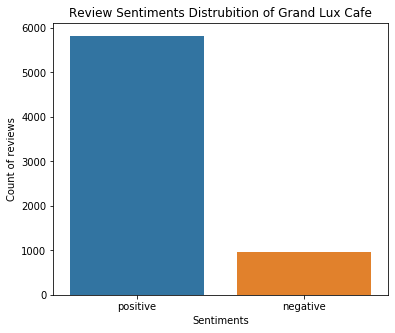

In [49]:
# Positive and Negative polarity comparison
plt.figure(figsize=(6,5))
ax = sns.countplot(yelp_df['sentiment'])
plt.title('Review Sentiments Distrubition of Grand Lux Cafe')
plt.xlabel('Sentiments')
plt.ylabel('Count of reviews')

In [50]:
# add number of characters column
GC_df["nb_chars"] = GC_df["text"].apply(lambda x: len(x))

# add number of words column
GC_df["nb_words"] = GC_df["text"].apply(lambda x: len(x.split(" ")))

In [51]:
# create doc2vec vector columns
documents = [TaggedDocument(doc, [i]) for i, doc in enumerate(GC_df["text_clean"].apply(lambda x: x.split(" ")))]
# train a Doc2Vec model with our text data
model = Doc2Vec(documents, vector_size=5, window=2, min_count=1, workers=4)
# transform each document into a vector data
doc2vec_df = GC_df["text_clean"].apply(lambda x: model.infer_vector(x.split(" "))).apply(pd.Series)
doc2vec_df.columns = ["doc2vec_vector_" + str(x) for x in doc2vec_df.columns]
GC_df = pd.concat([GC_df, doc2vec_df], axis=1)
GC_df

,text,text_clean,neg,neu,pos,compound,GC_sentiment_score,GC_sentiment,nb_chars,nb_words,doc2vec_vector_0,doc2vec_vector_1,doc2vec_vector_2,doc2vec_vector_3,doc2vec_vector_4
0,5 stars for the staff.\n\nPacked throughout th...,star staff.\n\npacked throughout day warm mont...,0.000,0.904,0.096,0.8990,0.151786,positive,707,120,-1.093474,0.421913,-0.571177,0.029628,0.905405
1,This review is purely for the late night dinin...,review purely late night din order take one ni...,0.062,0.887,0.051,-0.2658,0.002814,positive,541,100,-0.165555,0.194879,-0.278069,0.048327,0.217089
2,Another Dessert Adventure in the middle of the...,another dessert adventure middle night feel hu...,0.000,0.826,0.174,0.9791,0.238325,positive,1069,151,-0.788583,0.405646,-0.544574,-0.127510,0.830212
3,Went to the Grand Lux Cafe while at the Palazz...,go grand lux cafe palazzo own cheesecake facto...,0.026,0.835,0.138,0.8402,0.190000,positive,399,77,-0.322700,0.151121,-0.104721,0.063552,0.386176
4,Ok so we got here for lunch the other day got ...,ok get lunch day get seat right away.\n\nbut t...,0.084,0.851,0.065,-0.3777,0.165472,positive,661,129,-0.479727,0.194014,-0.330102,0.072992,0.533907
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1220,Awesome service and food. Come here every year...,awesome service food come every year ces isc s...,0.000,0.696,0.304,0.8519,1.000000,positive,121,21,-0.068929,0.065466,-0.156529,0.015651,0.201780
1221,Really excellent food from the creators of the...,really excellent food creator cheesecake facto...,0.023,0.717,0.260,0.9576,0.469388,positive,374,68,-0.240029,0.182264,-0.206116,0.000885,0.287269
1222,Great food. Service was a little slow. Try the...,great food service little slow try mushroom bu...,0.000,0.767,0.233,0.8360,0.199745,positive,163,29,0.028911,-0.034049,-0.085045,0.047173,0.006764
1223,"This restaurant was amazing, you have to try s...",restaurant amaze try steak desert here.\nalso ...,0.000,0.634,0.366,0.9641,0.500000,positive,188,35,-0.184238,0.065036,-0.140555,-0.093480,0.224443


In [52]:
# add tf-idfs columns
tfidf_GC = TfidfVectorizer(min_df = 10)
tfidf_GC_result = tfidf_GC.fit_transform(GC_df["text_clean"]).toarray()
tfidf_GC_df = pd.DataFrame(tfidf_GC_result, columns = tfidf_GC.get_feature_names())
tfidf_GC_df.columns = ["word_" + str(x) for x in tfidf_GC_df.columns]
tfidf_GC_df.index = GC_df.index
GC_df = pd.concat([GC_df, tfidf_GC_df], axis=1)
tfidf_GC_df

,word_able,word_absolutely,word_accommodate,word_across,word_actual,word_actually,word_add,word_admit,word_affordable,word_afternoon,...,word_write,word_wrong,word_year,word_yelp,word_yes,word_yet,word_you,word_yum,word_yummy,word_zen
0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.200476,0.0,0.000000,0.0
1,0.0,0.153151,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0
2,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0
3,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0
4,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1220,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.381391,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0
1221,0.0,0.000000,0.0,0.0,0.0,0.191434,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.192991,0.0
1222,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0
1223,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0


In [53]:
GC_df_pos = pd.DataFrame(GC_df['text_clean'][GC_df['GC_sentiment'] == 'positive'])
GC_df_neg = pd.DataFrame(GC_df['text_clean'][GC_df['GC_sentiment'] == 'negative'])

In [58]:
GC_df_add_stopwords = ['cheesec','fav','serv','zen','cafe', 'every', 'right', 'review','et', 'servic', 'gawd', 'nov', 'glux', 'ch', 'nice','bu', 'nalso', 'isc', 'ni', 'len', 'late', 'nbut', 'ces', 'hu', 'slow','mont', 'npacked', 'another','breakfas','chicago', 'loca', 'anthony', 'disappointed', 'angelinas', 'yelp', 'new', 'cold', 'hot', 'ol', 'sa', 'seem', 'eback', 'ne', 'felt', 'day', 'almost', 'normally', 'cam', 'spend', 'dog', 'fan', 'use', 'hour', 'sigh', 'big', 'windy', 'skinny', 'previously', 'seriously', 'give', 'st', 'restaur', 'buffalo', 'want', 'ngra', 'year', 'call','disappointing', 'vegas', 'city', 'house', 'yum', 'pt', 'beef', 'something', 'must', 'look', 'write', 'take', 'waste', 'different','soggy','disappoint','half','come','accu','non','aroun','ny','ok','las','anyon', 'ding','sadl','keep','yelped','lux', 'grand','columns','The','foo','I','ve','sp','kep','positive','negative', 'text_clean', 'nb_words', 'sentiment score', 'word_year', 'word_yummy', 'word_yum', 'word_yet', 'word_young', 'word_zucchni', 'word_york', 'word_you', 'word_yelp', 'word_yes', 'nb_chars', 'rows', 'sta', 'la', 'neg', 'pos', 'Th']


# Add meaningless words into stopwords
for i in range(len(GC_df_add_stopwords)):
    STOPWORDS.add(GC_df_add_stopwords[i])

In [59]:
# wordcloud function

def show_wordcloud_GC(data, title):
    wc_GC = WordCloud(
        background_color = 'white',
        max_words = 200,
        max_font_size = 40, 
        scale = 3,
        random_state = 42,
        stopwords = set(STOPWORDS)
    ).generate(str(data))

    fig = plt.figure(1, figsize = (20, 20))
    plt.axis('off')
    if title: 
        plt.title(title, fontsize=40,color='Black')

    plt.imshow(wc_GC)
    plt.show()
    


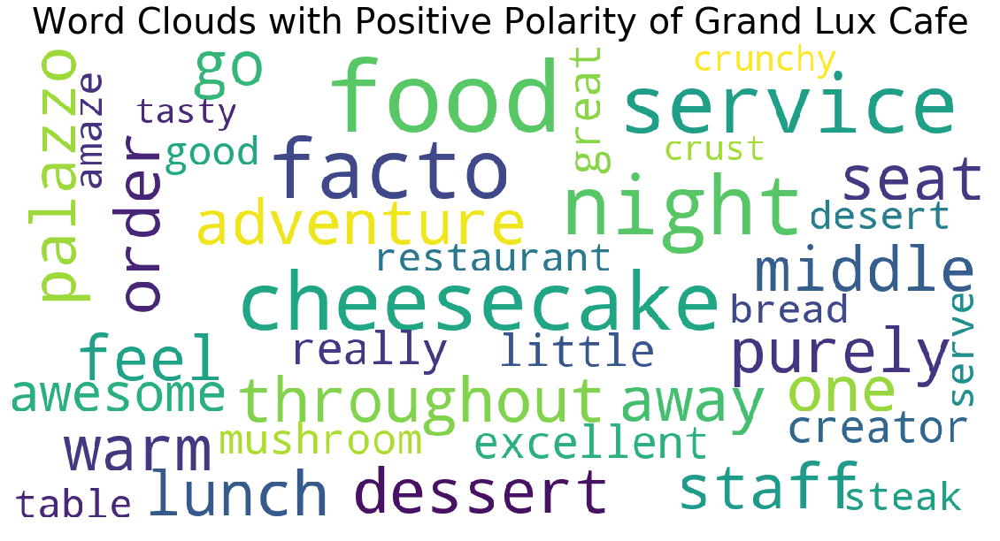

In [60]:
# print wordcloud
show_wordcloud_GC(GC_df_pos, "Word Clouds with Positive Polarity of Grand Lux Cafe")

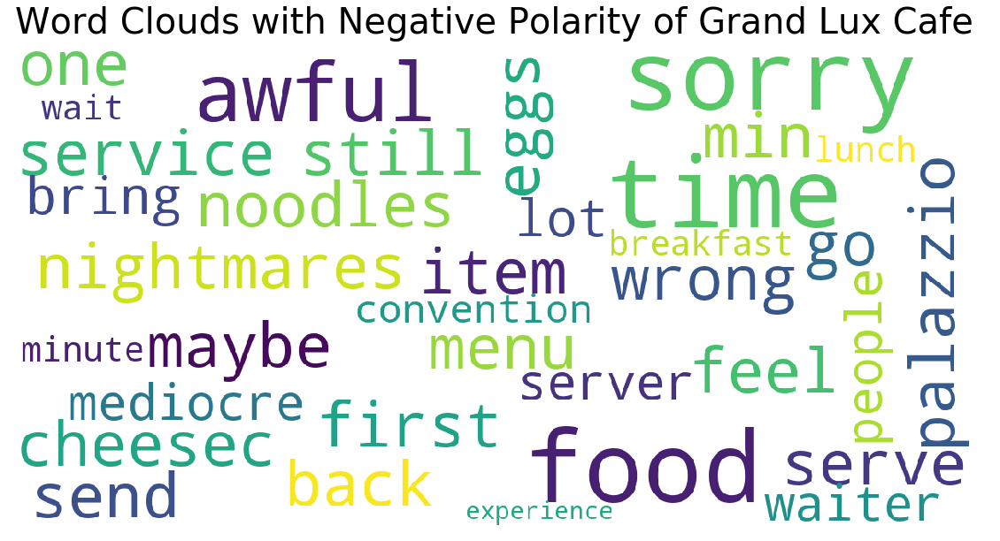

In [61]:
show_wordcloud_GC(GC_df_neg, "Word Clouds with Negative Polarity of Grand Lux Cafe ")

In [72]:
# Review text Analysis for the period from 2012 - 2013 and from 2013 to 2014 to check what made the rest to loose traffic and gain it.

GC_drop = pd.read_excel(r'GC_drop_12-13.xlsx')
GC_drop = GC_drop.drop(['text_length','Unnamed: 0','business_id', 'name_x', 'date', 'user_id', 'review_id', 'stars_y', 'useful_y', 'funny_y','cool_y', 'year','month','year_month'], axis = 1)
GC_drop

,text
0,5 stars for the staff.\n\nPacked throughout th...
1,Ok so we got here for lunch the other day got ...
2,Here's an interesting fact: Grand Lux Cafe is...
3,"Ok, maybe its just me but I feel like Grand Lu..."
4,Love the Carrot Cake!! Have had good meals and...
...,...
241,Dont know where to start....\nEven their ice w...
242,Came here with the fam on our recent trip to v...
243,We have had breakfast there two mornings in a ...
244,Really excellent food from the creators of the...


In [73]:
# clean text data
GC_drop["drop_text_clean"] = GC_df["text"].apply(lambda x: clean_text(x))
GC_drop.shape

[('stars', 'NNS'), ('staff.\n\npacked', 'VBD'), ('throughout', 'IN'), ('day', 'NN'), ('warmer', 'JJ'), ('months', 'NNS'), ('basically', 'RB'), ('cheesecake', 'VBP'), ('factory', 'NN'), ('shortened', 'VBN'), ('dining', 'VBG'), ('menu', 'NN'), ('extended', 'VBD'), ('drink', 'NN'), ('menu', 'NN'), ('wonder', 'NN'), ('breakfast', 'NN'), ('brunch', 'NN'), ('service', 'NN'), ('highlight', 'VBD'), ('morning', 'NN'), ('options.\n\nyou', 'NN'), ('get', 'VBP'), ('showbiz', 'JJ'), ('locals', 'NNS'), ('still', 'RB'), ('think', 'VBP'), ('cheesecake', 'VB'), ('factory', 'NN'), ('something', 'NN'), ('miraculous', 'JJ'), ('short-term', 'JJ'), ('general', 'JJ'), ('hospital', 'NN'), ('actress', 'NN'), ('gone', 'VBN'), ('internet', 'JJ'), ('soap', 'NN'), ('acting', 'VBG'), ('go', 'VB'), ('little', 'JJ'), ('diva', 'JJ'), ('us', 'PRP'), ('clearly', 'RB'), ('wanted', 'VBD'), ('attention', 'NN'), ('however', 'RB'), ('prominently', 'RB'), ('sat', 'JJ'), ('end', 'NN'), ('aisle', 'NN'), ('booth...in', 'NN'), ('

(246, 2)

In [74]:
# add sentiment anaylsis columns
# Using vader lexicon of nltk package we assign sentiment to words with the help of SentimentIntensityAnalyzer  
sid = SentimentIntensityAnalyzer()
GC_drop["GC_drop_sentiments"] = GC_drop["text"].apply(lambda x: sid.polarity_scores(x))
GC_drop = pd.concat([GC_drop.drop(['GC_drop_sentiments'], axis=1), GC_drop['GC_drop_sentiments'].apply(pd.Series)], axis=1)

GC_drop.shape

(246, 6)

In [75]:
GC_drop['GC_drop_sentiments_score'] = GC_drop['text'].map(lambda text: TextBlob(text).sentiment.polarity)

#classify sentiment into positive and negative ones
GC_drop['GC_drop_sentiment'] = ''
GC_drop['GC_drop_sentiment'][GC_drop['GC_drop_sentiments_score'] > 0] = 'positive'
GC_drop['GC_drop_sentiment'][GC_drop['GC_drop_sentiments_score'] <= 0] = 'negative'

GC_drop.shape
GC_drop.head(10)

D:\IDE\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
D:\IDE\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,text,drop_text_clean,neg,neu,pos,compound,GC_drop_sentiments_score,GC_drop_sentiment
0,5 stars for the staff.\n\nPacked throughout th...,star staff.\n\npacked throughout day warm mont...,0.000,0.904,0.096,0.8990,0.151786,positive
1,Ok so we got here for lunch the other day got ...,review purely late night din order take one ni...,0.084,0.851,0.065,-0.3777,0.165472,positive
2,Here's an interesting fact: Grand Lux Cafe is...,another dessert adventure middle night feel hu...,0.014,0.891,0.095,0.7862,0.272701,positive
3,"Ok, maybe its just me but I feel like Grand Lu...",go grand lux cafe palazzo own cheesecake facto...,0.095,0.766,0.139,0.8313,-0.004740,negative
4,Love the Carrot Cake!! Have had good meals and...,ok get lunch day get seat right away.\n\nbut t...,0.146,0.555,0.299,0.7835,0.240179,positive
5,NOM NOM NOM NOM NOM with a side of NOM. So goo...,here's interest fact grand lux cafe own cheese...,0.000,0.658,0.342,0.9382,0.812500,positive
6,"one of the best places in Vegas, open 24 hours...",use think fan grand lux cafe guiltily love che...,0.000,0.573,0.427,0.9341,0.515000,positive
7,I work at the Cheesecake Factory in Chicago so...,love come affordable tasty comfort food vega r...,0.000,0.727,0.273,0.9915,0.340521,positive
8,First the hostess with the red bob sucks at he...,ok maybe feel like grand lux look like cheesec...,0.083,0.863,0.055,-0.4215,0.040476,positive
9,I always enjoy coming here\n\nBig portions and...,love carrot cake good meal bad good service te...,0.000,0.821,0.179,0.9196,0.404004,positive


Text(0, 0.5, 'Count of reviews')

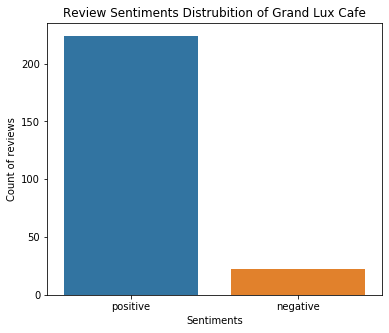

In [76]:
plt.figure(figsize=(6,5))
ax = sns.countplot(GC_drop['GC_drop_sentiment'])
plt.title('Review Sentiments Distrubition of Grand Lux Cafe')
plt.xlabel('Sentiments')
plt.ylabel('Count of reviews')

In [77]:
# create doc2vec vector columns

documents = [TaggedDocument(doc, [i]) for i, doc in enumerate(GC_drop["drop_text_clean"].apply(lambda x: x.split(" ")))]

# train a Doc2Vec model with our text data
model_1 = Doc2Vec(documents, vector_size=5, window=2, min_count=1, workers=4)

# transform each document into a vector data
doc2vec_df = GC_drop["drop_text_clean"].apply(lambda x: model_1.infer_vector(x.split(" "))).apply(pd.Series)
doc2vec_df.columns = ["doc2vec_vector_" + str(x) for x in doc2vec_df.columns]
GC_drop = pd.concat([GC_drop, doc2vec_df], axis=1)
GC_drop

,text,drop_text_clean,neg,neu,pos,compound,GC_drop_sentiments_score,GC_drop_sentiment,doc2vec_vector_0,doc2vec_vector_1,doc2vec_vector_2,doc2vec_vector_3,doc2vec_vector_4
0,5 stars for the staff.\n\nPacked throughout th...,star staff.\n\npacked throughout day warm mont...,0.000,0.904,0.096,0.8990,0.151786,positive,-0.150826,-0.135531,-0.056491,-0.031891,0.840511
1,Ok so we got here for lunch the other day got ...,review purely late night din order take one ni...,0.084,0.851,0.065,-0.3777,0.165472,positive,0.012158,0.057020,-0.078755,0.025575,0.475580
2,Here's an interesting fact: Grand Lux Cafe is...,another dessert adventure middle night feel hu...,0.014,0.891,0.095,0.7862,0.272701,positive,-0.057976,-0.127107,-0.129967,-0.153351,1.265924
3,"Ok, maybe its just me but I feel like Grand Lu...",go grand lux cafe palazzo own cheesecake facto...,0.095,0.766,0.139,0.8313,-0.004740,negative,-0.013160,-0.030646,0.059777,-0.030339,0.506658
4,Love the Carrot Cake!! Have had good meals and...,ok get lunch day get seat right away.\n\nbut t...,0.146,0.555,0.299,0.7835,0.240179,positive,-0.061488,-0.133796,-0.050600,0.058153,0.793062
...,...,...,...,...,...,...,...,...,...,...,...,...,...
241,Dont know where to start....\nEven their ice w...,brother love place cheesecake factory own plac...,0.000,0.665,0.335,0.8908,0.762500,positive,-0.047100,-0.070516,0.014630,-0.092133,0.503217
242,Came here with the fam on our recent trip to v...,come lunch sunday busy wait long get table wai...,0.015,0.897,0.087,0.9257,0.055637,positive,0.020717,-0.092208,-0.034058,-0.119655,0.479888
243,We have had breakfast there two mornings in a ...,husband ate grand lux last morning vega send b...,0.000,0.591,0.409,0.9345,0.933333,positive,0.026829,-0.135521,-0.094069,0.034681,0.658670
244,Really excellent food from the creators of the...,stay palazzo grand lux easy stroll room quick ...,0.023,0.717,0.260,0.9576,0.469388,positive,-0.077655,-0.115660,-0.039330,0.049840,0.483814


In [78]:
# add tf-idfs columns

tfidf = TfidfVectorizer(min_df = 10)
tfidf_result = tfidf.fit_transform(GC_drop["drop_text_clean"]).toarray()
tfidf_df = pd.DataFrame(tfidf_result, columns = tfidf.get_feature_names())
tfidf_df.columns = ["word_" + str(x) for x in tfidf_df.columns]
tfidf_df.index = GC_drop.index
GC_drop = pd.concat([GC_drop, tfidf_df], axis=1)
tfidf_df

,word_actually,word_add,word_ahi,word_almost,word_already,word_also,word_although,word_always,word_amaze,word_american,...,word_we,word_well,word_white,word_without,word_worth,word_would,word_wrap,word_yes,word_yet,word_yummy
0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.000000
1,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.000000
2,0.0,0.0,0.0,0.117878,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.000000
3,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.000000
4,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.123944,0.000000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.000000
242,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.000000
243,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.210364,0.0,...,0.000000,0.122124,0.0,0.0,0.0,0.1396,0.0,0.0,0.0,0.000000
244,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.000000


In [81]:
GC_drop_pos = pd.DataFrame(GC_drop['drop_text_clean'][GC_drop['GC_drop_sentiment'] == 'positive'])
GC_drop_neg = pd.DataFrame(GC_drop['drop_text_clean'][GC_drop['GC_drop_sentiment'] == 'negative'])

In [90]:
GC_df_add_stopwords_1213 = ['wait','middle','order','one','good','food','degree','definitely','advise','conveniently','hearty','note','beignets','chain','version','orleans','awesome','divide','extremely','diner','nex','pretty','stuff','facto','stuff','yass','remember','delicious','past','often','favorite','recently','basically', 'end','around','actually','terrific','expect','porti','liked','lax','face','see','baz','re','nthi','nicer','da','hote','generou','venetian','etc','sister','cr','plen','cheesec','','da','fact','due','brother','husband','send','throughout','busy','fo','wai','plac','cr','drop_text_clean','cafe', 'every', 'right', 'review','et', 'servic', 'gawd', 'nov', 'glux', 'ch', 'nice','bu', 'nalso', 'isc', 'ni', 'len', 'late', 'nbut', 'ces', 'hu', 'slow','mont', 'npacked', 'another','breakfas','chicago', 'loca', 'anthony', 'disappointed', 'angelinas', 'yelp', 'new', 'cold', 'hot', 'ol', 'sa', 'seem', 'eback', 'ne', 'felt', 'day', 'almost', 'normally', 'cam', 'spend', 'dog', 'fan', 'use', 'hour', 'sigh', 'big', 'windy', 'skinny', 'previously', 'seriously', 'give', 'st', 'restaur', 'buffalo', 'want', 'ngra', 'year', 'call','disappointing', 'vegas', 'city', 'house', 'yum', 'pt', 'beef', 'something', 'must', 'look', 'write', 'take', 'waste', 'different','soggy','disappoint','half','come','accu','non','aroun','ny','ok','las','anyon', 'ding','sadl','keep','yelped','lux', 'grand','columns','The','foo','I','ve','sp','kep','positive','negative', 'text_clean', 'nb_words', 'sentiment score', 'word_year', 'word_yummy', 'word_yum', 'word_yet', 'word_young', 'word_zucchni', 'word_york', 'word_you', 'word_yelp', 'word_yes', 'nb_chars', 'rows', 'sta', 'la', 'neg', 'pos', 'Th']


# Add meaningless words into stopwords
for i in range(len(GC_df_add_stopwords_1213)):
    STOPWORDS.add(GC_df_add_stopwords_1213[i])

In [91]:
# wordcloud function

def show_wordcloud(data, title):
    wordcloud = WordCloud(
        background_color = 'white',
        max_words = 200,
        max_font_size = 40, 
        scale = 3,
        random_state = 42,
        stopwords = set(STOPWORDS)
    ).generate(str(data))

    fig = plt.figure(1, figsize = (20, 20))
    plt.axis('off')
    if title: 
        plt.title(title, fontsize=40,color='Black')

    plt.imshow(wordcloud)
    plt.show()
    

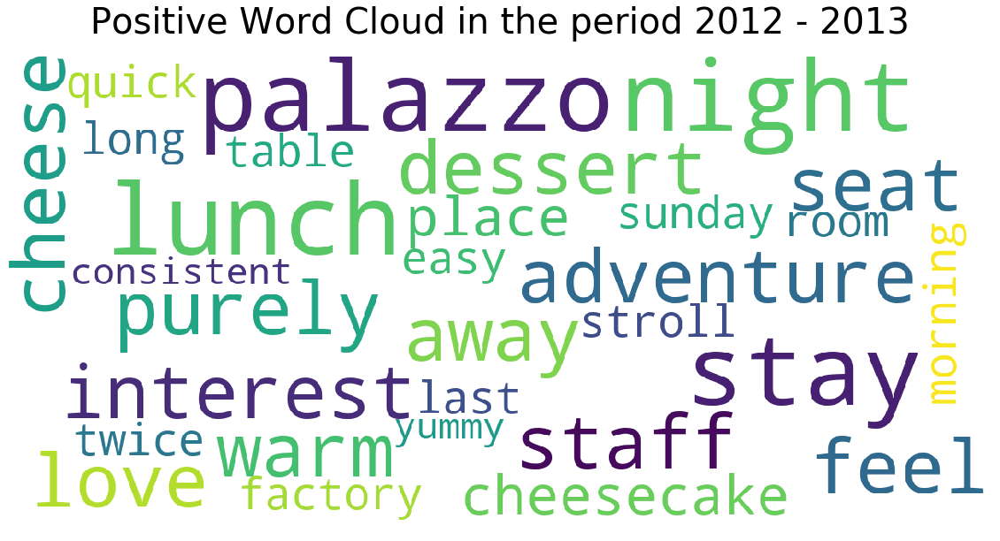

In [92]:
# print wordcloud
show_wordcloud(GC_drop_pos, "Positive Word Cloud in the period 2012 - 2013")

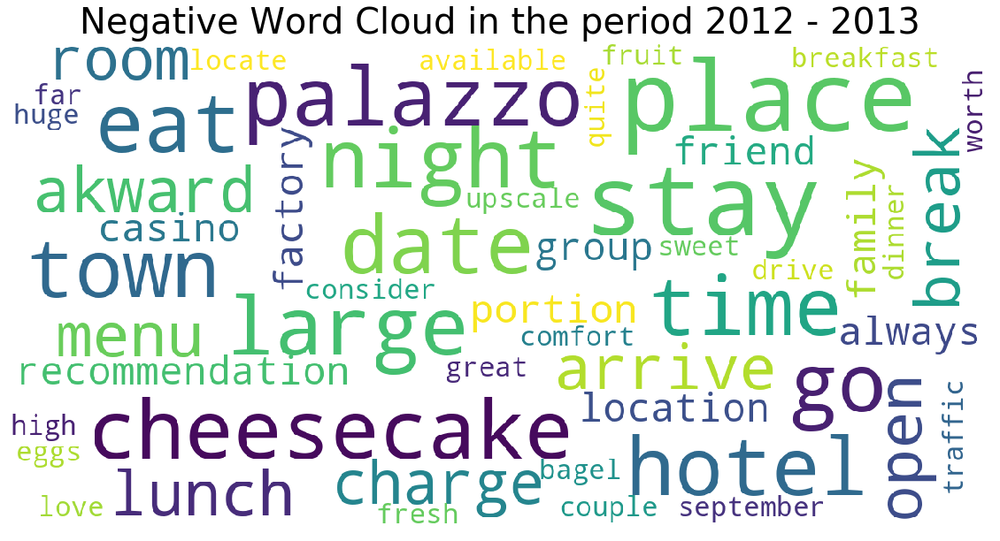

In [93]:
show_wordcloud(GC_drop_neg, "Negative Word Cloud in the period 2012 - 2013")